# FINAL PROJECT (DATA - 601)

## PROJECT MAIN AIM.
* 
The aim of my project is to compare the GDP with average electric consumption per head and GDP with pollutants per sq mile of each state in US.

## REASON.
* Pollution and power usage are two pressing challenges in today's globe. So I decided to perform some EDA on how pollution emissions and electricity usage are related to a state's GDP.

## Questions

* Will a state's ascending order of Electric Consumption per capita be almost identical to its ascending order of GDP percapita?


* Will pollution levels per square mile be greater in states with higher GDP?

## Data Source:-

* [US state wise GDP](https://data.world/garyhoov/gdp-by-state-2000-2015/workspace/file?filename=GDP+by+State+2000+2005+2010+2015+with+Share+and+Growth+Rate.xlsx)

* [State wise Carbon Dioxide Emissions](https://www.eia.gov/environment/emissions/state/analysis/)

* [US State wise power emissions](https://www.eia.gov/electricity/data/state/)

* [US State wise census](https://data.world/devtl/u-s-state-populations/workspace/file?filename=PEP_2016_PEPANNRES_with_ann.csv())

* [Area of each state in US](https://www.kaggle.com/giodev11/usstates-dataset#state-areas.csv)

## Unit of Analysis
* Analysing the US states electric counsumption per capita, pollution emitted per sq mile vs the GDP of each state.

## Variables/Measures Used in Analysis.
* GDP per state, CO2 emissions per state, power consumption per state, population per state, and state area

In [2]:
import pandas
import matplotlib
import matplotlib.pyplot as plt

In [3]:
# Loading GDP of State in us into df1 dataframe
df1 = pandas.read_excel("GDP_by_State.xlsx")

In [4]:
df1

,Area,2000 ($MM),2005 ($MM),2010 ($MM),2015 ($MM),2000 % of Total,2015 % of Total,2000-15 Compound Growth Rate,Growth Rate Rank,Change in % 2000-15
0,United States,10219801.0,13015161.0,14859772.0,17919651.0,1.000000,1.000000,0.038148,NaN,0.000000e+00
1,Alabama,119020.0,156750.0,174710.0,199656.0,0.011646,0.011142,0.035089,35.0,-5.042845e-04
2,Alaska,26853.0,40063.0,54134.0,52747.0,0.002628,0.002944,0.046037,10.0,3.159820e-04
3,Arizona,165912.0,227358.0,245668.0,290903.0,0.016234,0.016234,0.038145,22.0,-6.244915e-07
4,Arkansas,68809.0,90319.0,102951.0,118907.0,0.006733,0.006636,0.037140,28.0,-9.734547e-05
...,...,...,...,...,...,...,...,...,...,...
67,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
68,Legend / Footnotes:,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Note-- NAICS Industry detail is based on the 2...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
70,Note-- Per capita real GDP statistics for 1997...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### To display all the rows in a dataframe 

In [5]:
pandas.set_option('display.max_rows', None)

In [6]:
print(df1)

                                                 Area  2000 ($MM)  2005 ($MM)  \
0                                       United States  10219801.0  13015161.0   
1                                             Alabama    119020.0    156750.0   
2                                              Alaska     26853.0     40063.0   
3                                             Arizona    165912.0    227358.0   
4                                            Arkansas     68809.0     90319.0   
5                                          California   1362995.0   1766693.0   
6                                            Colorado    181488.0    220454.0   
7                                         Connecticut    169004.0    210170.0   
8                                            Delaware     44851.0     53247.0   
9                                District of Columbia     60059.0     83586.0   
10                                            Florida    497541.0    700267.0   
11                          

### As there are columns other than the required columns consisting of GDP of the states, deleting those inapproriate columns is necessary

* Firstly drop all the columns with null values

In [7]:
df1 = df1.dropna(how='any',axis=0)

In [8]:
print(df1)

                    Area  2000 ($MM)  2005 ($MM)  2010 ($MM)  2015 ($MM)  \
1                Alabama    119020.0    156750.0    174710.0    199656.0   
2                 Alaska     26853.0     40063.0     54134.0     52747.0   
3                Arizona    165912.0    227358.0    245668.0    290903.0   
4               Arkansas     68809.0     90319.0    102951.0    118907.0   
5             California   1362995.0   1766693.0   1965886.0   2481348.0   
6               Colorado    181488.0    220454.0    253374.0    313748.0   
7            Connecticut    169004.0    210170.0    234528.0    252930.0   
8               Delaware     44851.0     53247.0     57471.0     68724.0   
9   District of Columbia     60059.0     83586.0    103831.0    122146.0   
10               Florida    497541.0    700267.0    735098.0    888087.0   
11               Georgia    306528.0    388342.0    412485.0    497944.0   
12                Hawaii     41472.0     58573.0     68225.0     80376.0   
13          

## Loading census data of the Unired States into a dataframe


In [9]:
df2 = pandas.read_csv("PEP_2016_PEPANNRES_with_ann.csv")

In [10]:
df2

,GEO.id,GEO.id2,GEO.display-label,rescen42010,resbase42010,respop72010,respop72011,respop72012,respop72013,respop72014,respop72015,respop72016
0,Id,Id2,Geography,"April 1, 2010 - Census","April 1, 2010 - Estimates Base",Population Estimate (as of July 1) - 2010,Population Estimate (as of July 1) - 2011,Population Estimate (as of July 1) - 2012,Population Estimate (as of July 1) - 2013,Population Estimate (as of July 1) - 2014,Population Estimate (as of July 1) - 2015,Population Estimate (as of July 1) - 2016
1,0100000US,NaN,United States,308745538,308758105,309348193,311663358,313998379,316204908,318563456,320896618,323127513
2,0400000US01,1,Alabama,4779736,4780131,4785492,4799918,4815960,4829479,4843214,4853875,4863300
3,0400000US02,2,Alaska,710231,710249,714031,722713,731089,736879,736705,737709,741894
4,0400000US04,4,Arizona,6392017,6392301,6408312,6467163,6549634,6624617,6719993,6817565,6931071
5,0400000US05,5,Arkansas,2915918,2916025,2921995,2939493,2950685,2958663,2966912,2977853,2988248
6,0400000US06,6,California,37253956,37254522,37332685,37676861,38011074,38335203,38680810,38993940,39250017
7,0400000US08,8,Colorado,5029196,5029324,5048644,5118360,5189867,5267603,5349648,5448819,5540545
8,0400000US09,9,Connecticut,3574097,3574114,3579899,3589893,3593795,3596003,3591873,3584730,3576452
9,0400000US10,10,Delaware,897934,897936,899816,907924,916993,925395,934948,944076,952065


In [11]:
df2.shape


(53, 12)

### Retrieving the values of GDP in the year 2010 of each state into a list named gdp_2010
### Retrieving the population of each state in the year 2010 into a list named pop_2010


In [12]:
gdp_2010 = df1['2010 ($MM)'].to_list()
pop_2010 = df2['respop72010'].tolist()

In [13]:
#slicing the list to get only desired results
pop_2010 = pop_2010[2:53]

In [14]:
len(pop_2010)

51

In [15]:
len(gdp_2010)

51

### Converting the values to integer type

In [16]:
for i in range(0, len(pop_2010)): 
    pop_2010[i] = int(pop_2010[i]) 

### Dividing the GDP of every state with its population to the get gdp percapita and appending the values obtained into a new empty list gbyp

In [17]:
gbyp = []
for i in range(0,51):
    gbyp.append(gdp_2010[i]/pop_2010[i])

In [18]:
df1['GDP_percapita']=gbyp

C:\Users\saket\AppData\Local\Temp/ipykernel_4504/3786283164.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['GDP_percapita']=gbyp


In [19]:
df1

,Area,2000 ($MM),2005 ($MM),2010 ($MM),2015 ($MM),2000 % of Total,2015 % of Total,2000-15 Compound Growth Rate,Growth Rate Rank,Change in % 2000-15,GDP_percapita
1,Alabama,119020.0,156750.0,174710.0,199656.0,0.011646,0.011142,0.035089,35.0,-5.042845e-04,0.036508
2,Alaska,26853.0,40063.0,54134.0,52747.0,0.002628,0.002944,0.046037,10.0,3.159820e-04,0.075815
3,Arizona,165912.0,227358.0,245668.0,290903.0,0.016234,0.016234,0.038145,22.0,-6.244915e-07,0.038336
4,Arkansas,68809.0,90319.0,102951.0,118907.0,0.006733,0.006636,0.037140,28.0,-9.734547e-05,0.035233
5,California,1362995.0,1766693.0,1965886.0,2481348.0,0.133368,0.138471,0.040750,16.0,5.102720e-03,0.052659
6,Colorado,181488.0,220454.0,253374.0,313748.0,0.017758,0.017509,0.037167,27.0,-2.498672e-04,0.050187
7,Connecticut,169004.0,210170.0,234528.0,252930.0,0.016537,0.014115,0.027244,50.0,-2.422245e-03,0.065512
8,Delaware,44851.0,53247.0,57471.0,68724.0,0.004389,0.003835,0.028859,49.0,-5.535180e-04,0.063870
9,District of Columbia,60059.0,83586.0,103831.0,122146.0,0.005877,0.006816,0.048464,8.0,9.395869e-04,0.171570
10,Florida,497541.0,700267.0,735098.0,888087.0,0.048684,0.049559,0.039382,21.0,8.753712e-04,0.038999


### Creating a new dataframe with electricity generation of each state for every month from different energy recources

In [20]:
df3 = pandas.read_excel('generation_monthly.xlsx',
              sheet_name='2010-2011_FINAL')

In [21]:
df3

,YEAR,MONTH,STATE,TYPE OF PRODUCER,ENERGY SOURCE,GENERATION (Megawatthours)
0,2010,1,AK,Total Electric Power Industry,Coal,5.857500e+04
1,2010,1,AK,Total Electric Power Industry,Petroleum,1.235980e+05
2,2010,1,AK,Total Electric Power Industry,Natural Gas,3.604050e+05
3,2010,1,AK,Total Electric Power Industry,Hydroelectric Conventional,1.337650e+05
4,2010,1,AK,Total Electric Power Industry,Wind,4.160000e+02
5,2010,1,AK,Total Electric Power Industry,Other Biomass,3.860000e+02
6,2010,1,AK,Total Electric Power Industry,Other,0.000000e+00
7,2010,1,AK,Total Electric Power Industry,Total,6.771450e+05
8,2010,1,AK,"Electric Generators, Electric Utilities",Coal,1.877800e+04
9,2010,1,AK,"Electric Generators, Electric Utilities",Petroleum,1.167360e+05


### Dropping all the unwanted rows from the above data frame
### Deleting the rows with cell value as US-TOTAL as we dont need the those rows

In [22]:

df3.drop(df3.loc[df3['STATE']=='US-TOTAL' ].index, inplace=True)

### Droping all the rows with data from 2011

In [23]:
df3.drop(df3.loc[df3['YEAR']==2011].index,inplace=True)

### Droping all the "energy source" rows ecpect that equal to total which helps us generate the whole resourse total

In [24]:
df3.drop(df3.loc[df3['ENERGY SOURCE']!='Total'].index,inplace=True)

In [25]:
df3

,YEAR,MONTH,STATE,TYPE OF PRODUCER,ENERGY SOURCE,GENERATION (Megawatthours)
7,2010,1,AK,Total Electric Power Industry,Total,677145.0
14,2010,1,AK,"Electric Generators, Electric Utilities",Total,623773.0
16,2010,1,AK,"Electric Generators, Independent Power Producers",Total,0.0
18,2010,1,AK,"Combined Heat and Power, Electric Power",Total,17360.0
22,2010,1,AK,"Combined Heat and Power, Commercial Power",Total,23503.0
26,2010,1,AK,"Combined Heat and Power, Industrial Power",Total,12508.0
36,2010,1,AL,Total Electric Power Industry,Total,13792398.0
44,2010,1,AL,"Electric Generators, Electric Utilities",Total,11753509.0
47,2010,1,AL,"Electric Generators, Independent Power Producers",Total,1333242.0
51,2010,1,AL,"Combined Heat and Power, Electric Power",Total,332372.0


In [26]:
df3.shape

(3360, 6)

In [27]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3360 entries, 7 to 22934
Data columns (total 6 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   YEAR                        3360 non-null   int64  
 1   MONTH                       3360 non-null   int64  
 2   STATE                       3360 non-null   object 
 3   TYPE OF PRODUCER            3360 non-null   object 
 4   ENERGY SOURCE               3360 non-null   object 
 5   GENERATION (Megawatthours)  3360 non-null   float64
dtypes: float64(1), int64(2), object(3)
memory usage: 183.8+ KB


### creating new df with state names and their abbrevations

In [28]:
df4=pandas.read_csv("state-abbrevs.csv")

In [29]:
### Taking state names and their abbrevations into a dictionary with abbrevations as key and state names as values 

In [30]:
st_dict = dict(zip(df4.abbreviation, df4.state))

In [31]:
# Replacing the abbrevations of state names with state names using the state_dict dictionary created

In [32]:

df3=df3.replace({"STATE": st_dict}) 

In [33]:
# Creating a new pandas series which sum up the electricity generated grouped by satae names

In [34]:

a=df3.groupby(['STATE'])['GENERATION (Megawatthours)'].sum()

In [35]:
# Converting the pandas series to dataframe

In [36]:

dfnew = a.to_frame()

In [37]:
# Taking the power generated by each state into a list

In [38]:

list_Megawatt=dfnew['GENERATION (Megawatthours)'].to_list()

### Dividing the power generated by each state with its population and appending it to a new list

In [39]:

list_Megawattperpop = []
for i in range(0,51):
    list_Megawattperpop.append(list_Megawatt[i]/pop_2010[i])

In [40]:
# Adding that list to df dataframe
df1['ELECTRICAL CONSUMPTION/POPULATION']=list_Megawattperpop 

C:\Users\saket\AppData\Local\Temp/ipykernel_4504/2986172950.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['ELECTRICAL CONSUMPTION/POPULATION']=list_Megawattperpop


In [41]:
# Taking the pollution excel sheet into a dataframe
df_pol = pandas.read_excel('table1 (1).xlsx',
              sheet_name='Sheet1',header = 4)

In [42]:
df_pol

,State,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,Percent,Absolute
0,Alabama,142.240000,133.63000,138.490000,139.360000,141.660000,143.330000,145.780000,147.430000,139.630000,120.100000,132.770000,129.930000,123.200000,120.910000,123.16000,120.140000,115.09000,-0.197028,-28.240000
1,Alaska,44.400000,43.50000,43.650000,43.730000,46.860000,48.220000,45.930000,44.230000,39.640000,38.000000,38.920000,38.790000,38.240000,36.180000,35.34000,36.230000,34.91000,-0.276027,-13.310000
2,Arizona,86.070000,88.43000,87.760000,89.610000,96.610000,96.680000,99.920000,101.880000,102.250000,93.400000,95.310000,93.380000,91.360000,95.190000,93.17000,90.950000,87.01000,-0.100021,-9.670000
3,Arkansas,63.600000,62.78000,61.300000,61.990000,62.350000,60.080000,61.960000,63.290000,64.140000,61.470000,65.810000,67.260000,66.010000,68.440000,69.00000,59.250000,62.41000,0.038782,2.330000
4,California,377.220000,381.69000,380.040000,368.910000,386.800000,383.750000,392.230000,397.350000,381.490000,368.130000,362.770000,348.620000,353.130000,355.990000,352.94000,360.790000,361.35000,-0.058371,-22.400000
5,Colorado,84.490000,92.58000,90.680000,90.060000,93.000000,95.210000,96.210000,98.820000,96.880000,92.720000,95.290000,91.630000,90.500000,91.140000,91.73000,90.420000,89.04000,-0.064804,-6.170000
6,Connecticut,42.960000,41.72000,40.080000,42.760000,44.600000,44.070000,41.030000,40.250000,37.670000,35.930000,36.270000,34.880000,34.140000,34.900000,35.15000,36.500000,34.30000,-0.221693,-9.770000
7,Delaware,15.960000,15.49000,15.240000,15.790000,16.000000,16.780000,15.730000,16.540000,15.620000,11.980000,11.270000,12.250000,13.380000,13.110000,12.75000,12.850000,13.31000,-0.206794,-3.470000
8,District of Columbia,4.290000,4.08000,4.170000,3.920000,4.000000,3.920000,3.180000,3.380000,3.080000,3.170000,3.210000,3.080000,2.650000,2.830000,3.02000,2.990000,2.76000,-0.295918,-1.160000
9,Florida,239.760000,238.58000,241.790000,245.930000,257.280000,260.660000,259.140000,256.840000,238.560000,224.270000,242.300000,229.220000,222.880000,222.020000,227.71000,232.190000,230.06000,-0.117394,-30.600000


In [43]:
# Taking co2 emmissions of each state into a list
list_pol = df_pol[2010].to_list()

In [44]:
# Slicing the lis for desired values
list_pol= list_pol[0:51]

In [45]:
len(list_pol)

51

In [46]:
# Taking the area of each state data ito a dataframe
df_a= pandas.read_csv("state-areas.csv")

In [47]:
df_a

,state,area (sq. mi)
0,Alabama,52423
1,Alaska,656425
2,Arizona,114006
3,Arkansas,53182
4,California,163707
5,Colorado,104100
6,Connecticut,5544
7,Delaware,1954
8,District of Columbia,68
9,Florida,65758


In [48]:
list_a = df_a['area (sq. mi)'].to_list()

In [49]:
# Dividing the co2 emissions of each state with its area and appending those values to a list 
list_p_a = []
for i in range(0,51):
    list_p_a.append(list_pol[i]/list_a[i])

In [50]:
# Addding that list as a column to a dataframe
df1['Pollution per Square mile'] = list_p_a

C:\Users\saket\AppData\Local\Temp/ipykernel_4504/1726983512.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1['Pollution per Square mile'] = list_p_a


In [51]:
# Generating a final new dateframe with required columns from df1 dataframe
df_f = df1[['Area','GDP_percapita','ELECTRICAL CONSUMPTION/POPULATION','Pollution per Square mile']]

In [52]:
df_f

,Area,GDP_percapita,ELECTRICAL CONSUMPTION/POPULATION,Pollution per Square mile
1,Alabama,0.036508,63.588242,0.002533
2,Alaska,0.075815,18.933565,0.000059
3,Arizona,0.038336,34.876878,0.000836
4,Arkansas,0.035233,41.752422,0.001237
5,California,0.052659,10.935490,0.002216
6,Colorado,0.050187,20.092838,0.000915
7,Connecticut,0.065512,18.631599,0.006542
8,Delaware,0.063870,12.508438,0.005768
9,District of Columbia,0.171570,0.660488,0.047206
10,Florida,0.038999,24.308424,0.003685


In [53]:
# Assigning ranks to each column and adding it as rank1, rank2 and rank3 columns respectively
df_f['R1'] = df_f['GDP_percapita'].rank(ascending = 0) 
df_f['R2'] = df_f['ELECTRICAL CONSUMPTION/POPULATION'].rank(ascending = 0) 
df_f['R3'] = df_f['Pollution per Square mile'].rank(ascending = 0) 

C:\Users\saket\AppData\Local\Temp/ipykernel_4504/2484426670.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_f['R1'] = df_f['GDP_percapita'].rank(ascending = 0)
C:\Users\saket\AppData\Local\Temp/ipykernel_4504/2484426670.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_f['R2'] = df_f['ELECTRICAL CONSUMPTION/POPULATION'].rank(ascending = 0)
C:\Users\saket\AppData\Local\Temp/ipykernel_4504/2484426670.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.


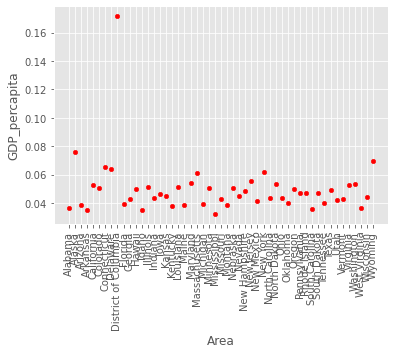

<Figure size 1200x960 with 0 Axes>

In [67]:
df_f.plot(kind='scatter',x='Area',y='GDP_percapita',color='red')
plt.xticks(rotation=90)
plt.figure(figsize=(15, 12), dpi=80)
plt.show()


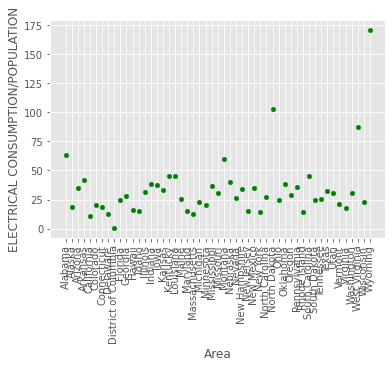

<Figure size 1200x960 with 0 Axes>

In [68]:
df_f.plot(kind='scatter',x='Area',y='ELECTRICAL CONSUMPTION/POPULATION',color='Green')
plt.xticks(rotation=90)
plt.figure(figsize=(15, 12), dpi=80)
plt.show()

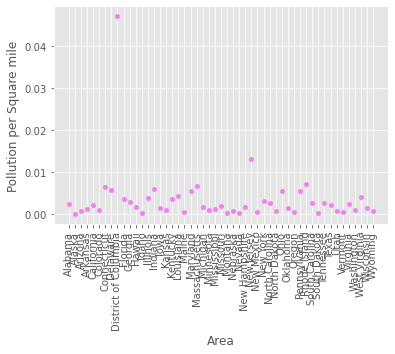

<Figure size 1200x960 with 0 Axes>

In [69]:
df_f.plot(kind='scatter',x='Area',y='Pollution per Square mile',color='violet')
plt.xticks(rotation=90)
plt.figure(figsize=(15, 12), dpi=80)
plt.show()

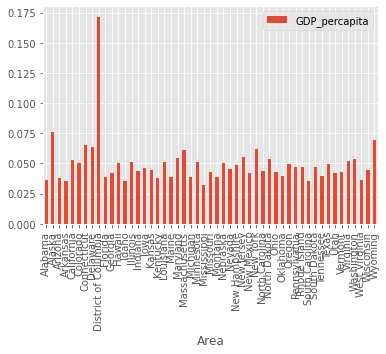

<Figure size 1200x960 with 0 Axes>

In [70]:
df_f.plot(kind='bar',x='Area',y='GDP_percapita')
plt.xticks(rotation=90)
plt.figure(figsize=(15, 12), dpi=80)
plt.show()

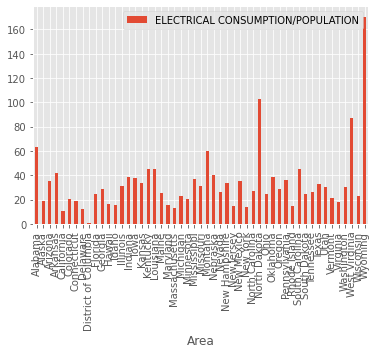

<Figure size 1200x960 with 0 Axes>

In [71]:
df_f.plot(kind='bar',x='Area',y='ELECTRICAL CONSUMPTION/POPULATION')
plt.xticks(rotation=90)
plt.figure(figsize=(15, 12), dpi=80)
plt.show()

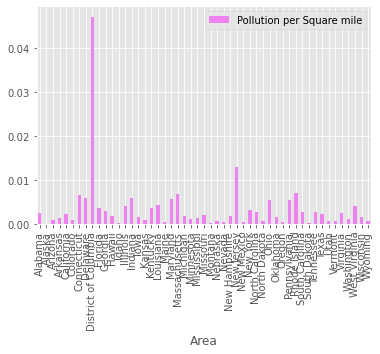

<Figure size 1200x960 with 0 Axes>

In [72]:
df_f.plot(kind='bar',x='Area',y='Pollution per Square mile',color='violet')
plt.xticks(rotation=90)
plt.figure(figsize=(15, 12), dpi=80)
plt.show()

### Will a state's ascending order of Electric Consumption per capita be almost identical to its ascending order of GDP per capita

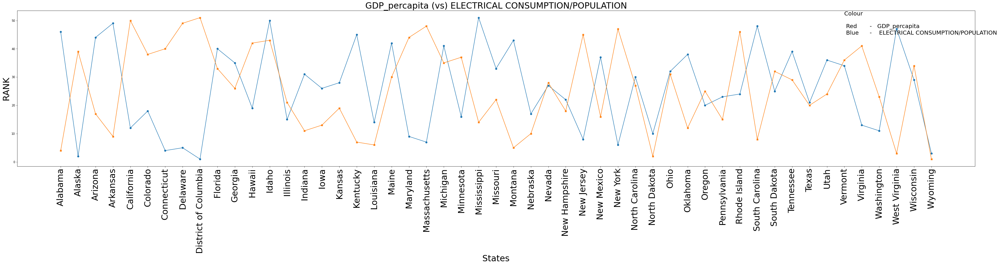

In [55]:
# Size of graph
f, ax = plt.subplots(figsize=(60,10))
plt.style.use('ggplot')
plt.title("GDP_percapita (vs) ELECTRICAL CONSUMPTION/POPULATION", fontsize=30)
plt.xlabel("States", fontsize=30)
plt.ylabel("RANK", fontsize=30)
plt.xticks(rotation='vertical',size=30)
y1=plt.plot(df_f['Area'],df_f['R1'],'-o')
y2=plt.plot(df_f['Area'],df_f['R2'],'-X')
plt.text(45,45,'Colour       \n \n Red       -   GDP_percapita\n Blue      -    ELECTRICAL CONSUMPTION/POPULATION',size=20)

plt.show()

### In the graph above, I attempted to compare each state's GDP/POPULATION rank with its ELECTRIC CONSUMPTION rank.
### However, I believe that in the vast majority of cases, a state's ascending order of electric consumption per capita differs from its ascending order of GDP per capita.




### Question 2:
    Will the pollutants per square mile of the states with higher GDP be more?

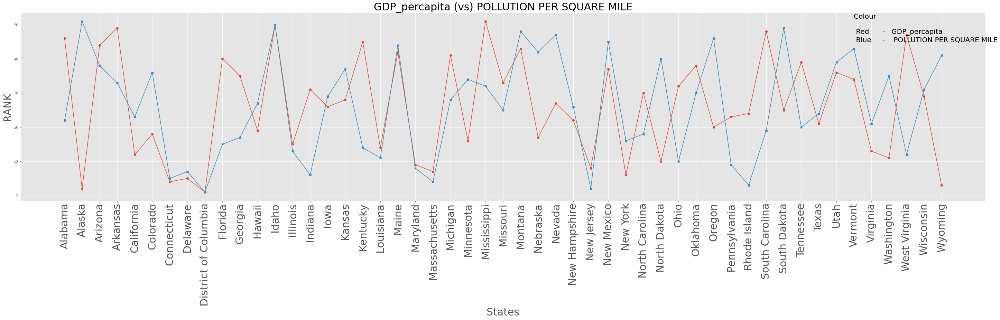

In [91]:
f, ax = plt.subplots(figsize=(50,10))
plt.style.use('ggplot')
#Title
plt.title("GDP_percapita (vs) POLLUTION PER SQUARE MILE", fontsize=30)
#X-label
plt.xlabel("States", fontsize=30)
#Y-label
plt.ylabel("RANK", fontsize=30)
plt.xticks(rotation='vertical',size=30)
#Plotting Rank of GDP/POPULATION
plt.plot(df_f['Area'],df_f['R1'],'-o')
#Plotting Rank of POLLUTION PER SQUARE MILE
plt.plot(df_f['Area'],df_f['R3'],'-X')
plt.text(45,45,'Colour       \n \n Red      -   GDP_percapita\n Blue     -    POLLUTION PER SQUARE MILE',size=20)



plt.show()

### If you look at the graph above, you'll notice that the Ranks of GDP/POPULATION and POLLUTION per SQUARE MILE are practically identically changing. I've produced another line graph to help clarify things.

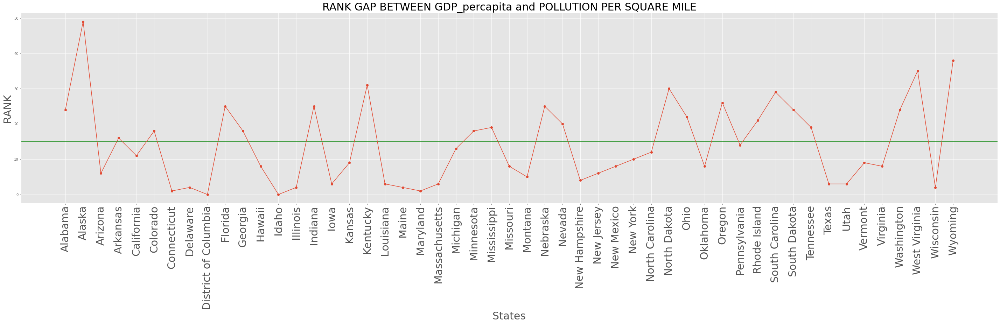

In [92]:
f, ax = plt.subplots(figsize=(50,10))
plt.style.use('ggplot')
plt.title("RANK GAP BETWEEN GDP_percapita and POLLUTION PER SQUARE MILE", fontsize=30)
plt.xlabel("States", fontsize=30)
plt.ylabel("RANK", fontsize=30)
plt.axhline(y=15,color='green')
plt.xticks(rotation='vertical',size=30)
plt.plot(df_f['Area'],abs(df_f['R1']-df_f['R3']),'-o')


plt.show()